<a href="https://colab.research.google.com/github/DAVIDCRUZ0202/Build2/blob/master/Build2_Project_David_Cruz.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Oil Spills Cause Detection Model

## Importing data, Exploratory Data Analysis, Baseline Establishments

In [0]:
import pandas as pd

In [0]:
import os
# dirname = os.path.dirname(__file__)
filename = os.path.join('C:\\Users\\David_Cruz\\Desktop\\Data-Science\\Build 2\\database.csv')

In [0]:
df = pd.read_csv(filename)

In [0]:
df.dtypes

Report Number                             int64
Supplemental Number                       int64
Accident Year                             int64
Accident Date/Time                       object
Operator ID                               int64
Operator Name                            object
Pipeline/Facility Name                   object
Pipeline Location                        object
Pipeline Type                            object
Liquid Type                              object
Liquid Subtype                           object
Liquid Name                              object
Accident City                            object
Accident County                          object
Accident State                           object
Accident Latitude                       float64
Accident Longitude                      float64
Cause Category                           object
Cause Subcategory                        object
Unintentional Release (Barrels)         float64
Intentional Release (Barrels)           

In [0]:
import pandas_profiling
pandas_profiling.ProfileReport(df)

### Creating our Baseline Target and checking Baseline Accuracy

In [0]:
# Our target is the "Cause Category". Let's change the type and refine it, to make it better for our model.

In [0]:
df['Cause Category'] = pd.Series(df['Cause Category'], dtype="category")

In [0]:
df['Cause Category'] = df['Cause Category'].cat.set_categories(["MATERIAL/WELD/EQUIP FAILURE",
                                                             "CORROSION", "INCORRECT OPERATION", "OTHER"])

In [0]:
df['Cause Category'] = df['Cause Category'].fillna(value='OTHER')

In [0]:
# Going to reduce the Cardinality of the Target, since the last 4
# classes are so small.

# df['Cause Category'] =dd df['Cause Category'].cat.rename_categories({("NATURAL FORCE DAMAGE" , "OTHER OUTSIDE FORCE DAMAGE",
#                                                                    "ALL OTHER CAUSES", "EXCAVATION DAMAGE"): "OTHER" })

# The above code line works for only one category class. If I try to rename
# more than one category to "Other", I'll raise an error due to uniqueness of
# the class values. Going to restart notebook, and try a new method. Keeping
# this for reference.

In [0]:
df['Cause Category'].value_counts(normalize=True)

MATERIAL/WELD/EQUIP FAILURE    0.513417
CORROSION                      0.211807
OTHER                          0.139535
INCORRECT OPERATION            0.135242
Name: Cause Category, dtype: float64

In [0]:
## Baseline

# Since our target is 'Cause Category', we can establish a baseline
# by checking the majority class rate, which clocks in at 51%. We can 
# positively confirm our baseline of 51% accuracy, which states that if we
# just guessed the majority class for every single instance of the data set,
# we would be correct 51% of the time. Now we'll train our model to learn
# how to beat that.

### Exploratory Data Analysis

In [0]:
df.head()

,Report Number,Supplemental Number,Accident Year,Accident Date/Time,Operator ID,Operator Name,Pipeline/Facility Name,Pipeline Location,Pipeline Type,Liquid Type,...,Other Fatalities,Public Fatalities,All Fatalities,Property Damage Costs,Lost Commodity Costs,Public/Private Property Damage Costs,Emergency Response Costs,Environmental Remediation Costs,Other Costs,All Costs
0,20100016,17305,2010,1/1/2010 7:15 AM,32109,ONEOK NGL PIPELINE LP,KINDER MORGAN JCT,ONSHORE,ABOVEGROUND,"HVL OR OTHER FLAMMABLE OR TOXIC FLUID, GAS",...,NaN,NaN,NaN,110.0,1517.0,0.0,0.0,0.0,0.0,1627
1,20100254,17331,2010,1/4/2010 8:30 AM,15786,PORTLAND PIPELINE CORP,24-INCH MAIN LINE,ONSHORE,ABOVEGROUND,CRUDE OIL,...,NaN,NaN,NaN,4000.0,8.0,0.0,0.0,0.0,0.0,4008
2,20100038,17747,2010,1/5/2010 10:30 AM,20160,"PETROLOGISTICS OLEFINS, LLC",NaN,ONSHORE,ABOVEGROUND,"HVL OR OTHER FLAMMABLE OR TOXIC FLUID, GAS",...,NaN,NaN,NaN,0.0,200.0,0.0,0.0,0.0,0.0,200
3,20100260,18574,2010,1/6/2010 7:30 PM,11169,"ENBRIDGE ENERGY, LIMITED PARTNERSHIP",SUPERIOR TERMINAL,ONSHORE,UNDERGROUND,CRUDE OIL,...,NaN,NaN,NaN,200.0,40.0,0.0,11300.0,0.0,0.0,11540
4,20100030,16276,2010,1/7/2010 1:00 PM,300,"PLAINS PIPELINE, L.P.",RED RIVER EAST,ONSHORE,UNDERGROUND,CRUDE OIL,...,NaN,NaN,NaN,20000.0,150.0,0.0,7500.0,2000.0,0.0,29650


In [0]:
df['Accident Year'].value_counts()

## This is how we will do our train test val split

2015    462
2014    454
2016    415
2013    401
2012    366
2010    350
2011    345
2017      2
Name: Accident Year, dtype: int64

In [0]:
For Train/Val/Test split, I will use years to separate each. I'll make the training set 2010-2012, and the validation set 2013-2015.My test set will be the year of 2016-17.This is a classification problem. The classes are fairly balanced with the majority class producing just over 51% of the results, and the other 3 classes making up the rest. As far as cleaning and exploration, we already know to remove the "Cause Subcategory". so that we remove data leakage associated with it. This Column is directly related to "Cause Category".


* Perform Split
* Wrangle Function
* Arrange Features and Targets
* Fit Model
* Validate
* permutations and feature importance


In [0]:
# Split
# These are time-based splits, so we will not use the model_selection of train_test_split
# We are splitting on the df['Accident Year']

import numpy as np
import pandas as pd

train = df[df['Accident Year'] <= 2012]
test = df[df['Accident Year'] >= 2016]
val = df[df['Accident Year'] >= 2013]
val = val[val['Accident Year'] < 2016]


print(train.shape, val.shape, test.shape)

print("Training Years:", train['Accident Year'].value_counts())

print("Validation Years:", val['Accident Year'].value_counts())

print("Testing Years:", test['Accident Year'].value_counts())

(1061, 48) (1317, 48) (417, 48)
Training Years: 2012    366
2010    350
2011    345
Name: Accident Year, dtype: int64
Validation Years: 2015    462
2014    454
2013    401
Name: Accident Year, dtype: int64
Testing Years: 2016    415
2017      2
Name: Accident Year, dtype: int64


### Data Wrangling

In [0]:
# Wrangle Research
# Any values to round to 0? no
# Any values with 0 that shouldnt? no
# Duplicate / Leaking Columns? Columns with Unique values or static values? **********Drop ['Report Number'], ['Cause Subcategory'], ['Supplemental Number'], ['Emergency Responder Injuries'], ['Other Injuries'], ['Operator Employee Fatalities'], ['Emergency Responder Fatalities']

df.nunique()

Report Number                           2795
Supplemental Number                     2795
Accident Year                              8
Accident Date/Time                      2777
Operator ID                              213
Operator Name                            229
Pipeline/Facility Name                  1977
Pipeline Location                          2
Pipeline Type                              4
Liquid Type                                5
Liquid Subtype                             8
Liquid Name                               69
Accident City                           1027
Accident County                          678
Accident State                            46
Accident Latitude                       2552
Accident Longitude                      2557
Cause Category                             4
Cause Subcategory                         38
Unintentional Release (Barrels)          697
Intentional Release (Barrels)            117
Liquid Recovery (Barrels)                539
Net Loss (

In [0]:
# Going to remove the Operator ID feature, because it's necessarily holding
# the same information as the Operator name.

In [0]:
# Wrangle

def wrangle(X):
    """Wrangle train, validate, and test sets in the same way"""
    
    # Prevent SettingWithCopyWarning
    X = X.copy()

    # When columns have zeros and shouldn't, they are like null values.
    # So we will replace the zeros with nulls, and impute missing values later.

    
    # Drop Report Number and Supplemental Number( always varies), Cause Subcategory(data leakage)
    unusable_variance = ['Report Number', 'Cause Subcategory', 'Supplemental Number']
    X = X.drop(columns=unusable_variance)

    # Drop the columns with 0 feature importance
    more_variance = ['All Fatalities', 'Pipeline Location', 'Public Fatalities', 'Accident Date/Time',
                     'Accident Year', 'Liquid Explosion', 'Shutdown Date/Time', 'Restart Date/Time',
                     'Operator Employee Injuries', 'Operator Contractor Injuries', 'Emergency Responder Injuries',
                     'Other Injuries', 'Public Injuries', 'All Injuries', 'Operator Employee Fatalities',
                     'Operator Contractor Fatalities', 'Emergency Responder Fatalities', 'Other Fatalities', 
                    'Operator ID']

    X = X.drop(columns=more_variance)

    

    # Engineer features!
    
    # return the wrangled dataframe
    return X

train = wrangle(train)
val = wrangle(val)
test = wrangle(test)

### Feature and Target Creation

In [0]:
# Arrange data into X features matrix and Y target vector
target = 'Cause Category'
X_train = train.drop(columns=target)
y_train = train[target]
X_val = val.drop(columns=target)
y_val = val[target]
X_test = test.drop(columns=target)
y_test = test[target]

### Pickle Training

In [0]:
pickle_columns = ['Pipeline Type', 'Accident Longitude']
X_pickle = train[pickle_columns]

## Our First Model , XGBClassifier (Instantiation, Fit, Validation, Graphs)

In [0]:
# Create and fit
import category_encoders as ce
from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from xgboost import XGBClassifier
import matplotlib.pyplot as plt
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import StandardScaler

pipeline = make_pipeline(
    ce.OrdinalEncoder(),
    SimpleImputer(),
    XGBClassifier(n_estimators=100, random_state=42, n_jobs=-1)
)

### Fit

In [0]:
pipeline.fit(X_train, y_train)

Pipeline(steps=[('ordinalencoder',
                 OrdinalEncoder(cols=['Operator Name', 'Pipeline/Facility Name',
                                      'Pipeline Type', 'Liquid Type',
                                      'Liquid Subtype', 'Liquid Name',
                                      'Accident City', 'Accident County',
                                      'Accident State', 'Liquid Ignition',
                                      'Pipeline Shutdown'],
                                mapping=[{'col': 'Operator Name',
                                          'data_type': dtype('O'),
                                          'mapping': ONEOK NGL PIPELINE LP                       1
PORTLAND PIPELINE CORP                      2
PETROLOGIS...
SD     33
AK     34
SC     35
UT     36
NE     37
MT     38
AL     39
AR     40
MD     41
PR     42
CT     43
OR     44
dtype: int64},
                                         {'col': 'Liquid Ignition',
                                       

In [0]:
# Validate
# Let's see our validation accuracy
from sklearn.metrics import accuracy_score
y_pred = pipeline.predict(X_val)
print('Validation Accuracy', accuracy_score(y_val, y_pred))

Validation Accuracy 0.5763097949886105


We beat baseline without hypertuning! Examining our features through Permutations will be the first step. By seeing feature importance, we can adjust what we want our model to focus on.

### Permutation Importance

In [0]:
# Permutations
# We are only checking the feature importance of once feature in this cell.
# In the next cell, we check the importance of all features.
# Doing one Permutation manually just for the reps

feature = 'Operator Name'
X_val_permuted = X_val.copy()
X_val_permuted[feature] = np.random.permutation(X_val[feature])  # The line!
score_permuted = pipeline.score(X_val_permuted, y_val)  # The other line!
score_with = pipeline.score(X_val, y_val)
print(f'Validation Accuracy with {feature}: {score_with}')
print(f'Validation Accuracy with {feature} permuted: {score_permuted}')
print(f'Permutation Importance: {score_with - score_permuted}')



Validation Accuracy with Operator Name: 0.5763097949886105
Validation Accuracy with Operator Name permuted: 0.577828397873956
Permutation Importance: -0.0015186028853455547


In [0]:
## Now let's use the eli5 library

transformers = make_pipeline(
    ce.OrdinalEncoder(),
    SimpleImputer()
)

X_train_transformed = transformers.fit_transform(X_train)
X_val_transformed = transformers.transform(X_val)

model = XGBClassifier(n_estimators=100, random_state=42, n_jobs=-1)

model.fit(X_train_transformed, y_train)

XGBClassifier(n_jobs=-1, objective='multi:softprob', random_state=42)

In [0]:
import eli5
from eli5.sklearn import PermutationImportance
## Don't worry about the errors. We just pulled the transformers out of the 
## pipeline, and made a seperate variable for the transformers
## and the model itsself

C:\Users\David_Cruz\anaconda3\envs\unit2\lib\site-packages\sklearn\utils\deprecation.py:143: FutureWarning: The sklearn.metrics.scorer module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)
C:\Users\David_Cruz\anaconda3\envs\unit2\lib\site-packages\sklearn\utils\deprecation.py:143: FutureWarning: The sklearn.feature_selection.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.feature_selection. Anything that cannot be imported from sklearn.feature_selection is now part of the private API.
  warnings.warn(message, FutureWarning)


In [0]:
permuter = PermutationImportance( # begin the parameters for the permuter)
    model,# Using the model from our pipeline
    scoring='accuracy',
    n_iter=5,  # Run each permutation 5 times and take the average
    random_state=42 # This is our seed for reproducibility and model tuning
)

permuter.fit(X_val_transformed, y_val)

PermutationImportance(estimator=XGBClassifier(n_jobs=-1,
                                              objective='multi:softprob',
                                              random_state=42),
                      random_state=42, scoring='accuracy')

In [0]:
feature_names = X_val.columns.to_list()
pd.Series(permuter.feature_importances_, feature_names).sort_values(
    ascending=False)

Pipeline Type                           0.074108
Property Damage Costs                   0.015642
Liquid Subtype                          0.014579
Unintentional Release (Barrels)         0.013819
Liquid Ignition                         0.004708
All Costs                               0.004252
Accident Latitude                       0.002430
Liquid Name                             0.000911
Pipeline Shutdown                       0.000759
Operator Name                           0.000456
Public/Private Property Damage Costs    0.000304
Lost Commodity Costs                   -0.000304
Public Evacuations                     -0.000456
Pipeline/Facility Name                 -0.000456
Liquid Type                            -0.000607
Emergency Response Costs               -0.000759
Other Costs                            -0.001063
Intentional Release (Barrels)          -0.001215
Net Loss (Barrels)                     -0.003037
Environmental Remediation Costs        -0.003189
Liquid Recovery (Bar

In [0]:
# Let's Drop everything with 0 importance for a faster model. It won't decrease our score at all. 
# Lets keep it in the Wrangle function so that it's all being done in one shot.

## Go up to the wrangle function and pass in these columns to drop.

By completing the Permutation Importance, we can successfully remove all of the 0 importance features, and we can
learn more about what features are doing what to our model. From what I can see above, all of are features are contributing in some way to the model prediction, and they're all doing so in a fair way. If there was a feature which was giving us leakage, it would have to have permutation importance of magnitudes different from the rest.

### Hypertuning and Evaluation through Validation Curve

In [0]:
# Hypertuning
# We'll do this by trying different parameters on our model
# Stop using the pipeline approach just to try different parameters

encoder = ce.OrdinalEncoder()
X_train_encoded = encoder.fit_transform(X_train)
X_val_encoded = encoder.transform(X_val)
## Under this comment, I've created a new model with different parameters

model1 = XGBClassifier(
    n_estimators=1000,  # Number of estimators - with a lot, will depend on early stopping
    max_depth=7,  # Deeper trees to help with high cardinality features
    learning_rate=0.5,  # Let's try a higher learning rate
    n_jobs=-1
)
# Creating a set to use to evaluate our new model
eval_set = [(X_train_encoded, y_train),
            (X_val_encoded, y_val)]

model1.fit(X_train_encoded, y_train,
          eval_set=eval_set,
          eval_metric='merror',
          early_stopping_rounds=50)  # Stop if the score hasn't improved in 50 rounds

[0]	validation_0-merror:0.199812	validation_1-merror:0.48899
Multiple eval metrics have been passed: 'validation_1-merror' will be used for early stopping.

Will train until validation_1-merror hasn't improved in 50 rounds.
[1]	validation_0-merror:0.154571	validation_1-merror:0.481397
[2]	validation_0-merror:0.123468	validation_1-merror:0.490509
[3]	validation_0-merror:0.093308	validation_1-merror:0.471526
[4]	validation_0-merror:0.079171	validation_1-merror:0.470008
[5]	validation_0-merror:0.05278	validation_1-merror:0.473045
[6]	validation_0-merror:0.029218	validation_1-merror:0.474563
[7]	validation_0-merror:0.01508	validation_1-merror:0.484434
[8]	validation_0-merror:0.005655	validation_1-merror:0.479879
[9]	validation_0-merror:0.004713	validation_1-merror:0.47836
[10]	validation_0-merror:0.001885	validation_1-merror:0.480638
[11]	validation_0-merror:0	validation_1-merror:0.471526
[12]	validation_0-merror:0	validation_1-merror:0.474563
[13]	validation_0-merror:0	validation_1-merror

XGBClassifier(learning_rate=0.5, max_depth=7, n_estimators=1000, n_jobs=-1,
              objective='multi:softprob')

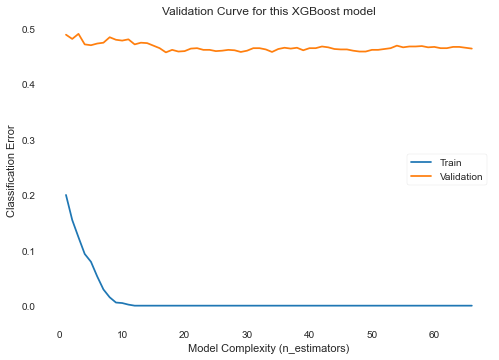

In [0]:
results = model1.evals_result()
train_error = results['validation_0']['merror']
val_error = results['validation_1']['merror']
epoch = list(range(1, len(train_error)+1))
plt.plot(epoch, train_error, label='Train')
plt.plot(epoch, val_error, label='Validation')
plt.ylabel('Classification Error')
plt.xlabel('Model Complexity (n_estimators)')
plt.title('Validation Curve for this XGBoost model')
#plt.ylim((0.18, 0.22)) # Zoom in
plt.legend();

In [0]:
1 - 0.457099

0.5429010000000001

In [0]:
# We're still beating baseline, but our model seems to plateau regardless of its complexity. 
# Our first model is still the best, hypertuning didn't help it that much.

### PDP for our XGBClassifier model, to see how our features are working with or against each other.

In [0]:
from sklearn.utils.multiclass import unique_labels
for i, label in enumerate(unique_labels(y_train)):
    print(f'Class {i} is {label}')


Class 0 is CORROSION
Class 1 is INCORRECT OPERATION
Class 2 is MATERIAL/WELD/EQUIP FAILURE
Class 3 is OTHER


In [0]:
from pdpbox.pdp import pdp_isolate, pdp_plot

feature = "Property Damage Costs"

isolated = pdp_isolate(
    model=pipeline,
    dataset=X_val,
    model_features=X_val.columns,
    feature=feature
)

In [0]:
isolated

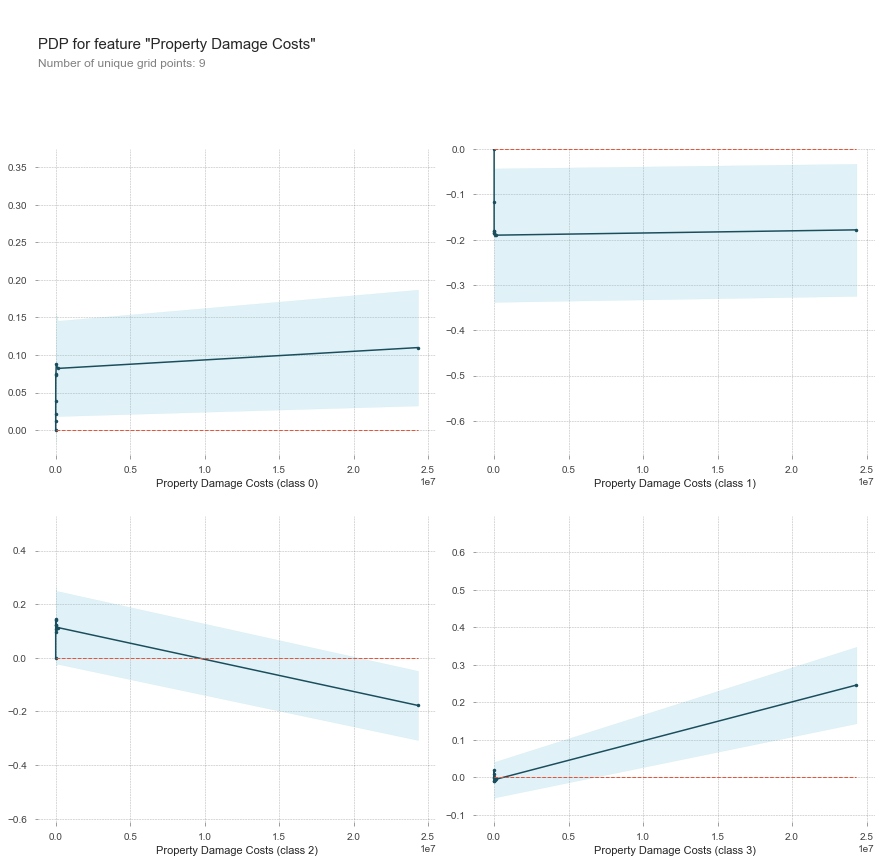

In [0]:
pdp_plot(isolated, feature_name=feature);

## Second Model, RandomForestClassifier, same workflow (No Permutations or Plots)

In [0]:
# lETS TRY A NEW MODEL!

pipeline4 = make_pipeline(
    ce.OrdinalEncoder(),
    SimpleImputer(),
    StandardScaler(),
    Normalizer(),
    RandomForestClassifier(n_jobs=-1, random_state=21)
)

In [0]:
pipeline4.fit(X_train, y_train)

Pipeline(steps=[('ordinalencoder',
                 OrdinalEncoder(cols=['Operator Name', 'Pipeline/Facility Name',
                                      'Pipeline Type', 'Liquid Type',
                                      'Liquid Subtype', 'Liquid Name',
                                      'Accident City', 'Accident County',
                                      'Accident State', 'Liquid Ignition',
                                      'Pipeline Shutdown'],
                                mapping=[{'col': 'Operator Name',
                                          'data_type': dtype('O'),
                                          'mapping': ONEOK NGL PIPELINE LP                       1
PORTLAND PIPELINE CORP                      2
PETROLOGIS...
dtype: int64},
                                         {'col': 'Liquid Ignition',
                                          'data_type': dtype('O'),
                                          'mapping': NO     1
YES    2
NaN   -2
dtype: int64

In [0]:
y_pred4 = pipeline4.predict(X_val)
print('Validation Accuracy', accuracy_score(y_val, y_pred4))

Validation Accuracy 0.5565679574791192


In [0]:
# Random forest gave us a model that also beats baseline, but it's not 
# as good as our XGBClassifier. Going to run with the XGB Classifier for my project
# but i'll keep this as a reference to my work flow.

## Logistic Regression Model

In [0]:
# let's try a Logistic Regression Model
from sklearn.linear_model import LogisticRegression

In [0]:
model304 = LogisticRegression(solver='lbfgs')

In [0]:
# It's still in a pipeline but after we try this model, we will do randomized 
# search CV for the model that makes the best model.

pipeline7 = make_pipeline(
    SimpleImputer(),
    StandardScaler(),
    LogisticRegression(),
)

In [0]:
pipeline7.fit(X_train_encoded, y_train)

Pipeline(steps=[('simpleimputer', SimpleImputer()),
                ('standardscaler', StandardScaler()),
                ('logisticregression', LogisticRegression())])

In [0]:
y_pred2 = pipeline7.predict(X_val_encoded)

In [0]:
print('Validation Accuracy', accuracy_score(y_val, y_pred2))

Validation Accuracy 0.530751708428246


In [0]:
# Well, our logistic regression model also beats baseline, but it's not as 
# good as our first model. After trying three models, our first one comes out
# on top. Time to do the final prediction on our test set, to get our final
# Accuracy score.

## Testing our best model for accuracy

In [0]:
y_predt = pipeline.predict(X_test)

In [0]:
print('Test Accuracy', accuracy_score(y_test, y_predt))

Test Accuracy 0.5299760191846523


In [0]:
# Beating baseline by 2 points.

## Building a new Pipeline and Pickling 

In [0]:
pickle = make_pipeline(
    ce.OrdinalEncoder(),
    SimpleImputer(),
    XGBClassifier(n_estimators=100, random_state=42, n_jobs=-1)
)

In [0]:
pickle.fit(X_pickle, y_train)

Pipeline(steps=[('ordinalencoder',
                 OrdinalEncoder(cols=['Pipeline Type'],
                                mapping=[{'col': 'Pipeline Type',
                                          'data_type': dtype('O'),
                                          'mapping': ABOVEGROUND        1
UNDERGROUND        2
TANK               3
NaN                4
TRANSITION AREA    5
dtype: int64}])),
                ('simpleimputer', SimpleImputer()),
                ('xgbclassifier',
                 XGBClassifier(n_jobs=-1, objective='multi:softprob',
                               random_state=42))])

In [0]:
from joblib import dump
dump(pickle, 'pickle.joblib', compress=True)

['pickle.joblib']

In [0]:
import joblib
import sklearn
import category_encoders as ce
import xgboost
print(f'joblib=={joblib.__version__}')
print(f'scikit-learn=={sklearn.__version__}')
print(f'category_encoders=={ce.__version__}')
print(f'xgboost=={xgboost.__version__}')

joblib==0.14.1
scikit-learn==0.23.0
category_encoders==2.2.2
xgboost==0.90


In [0]:
def prediction(Pipeline_type, Accident_longitude):
    df9 = pd.DataFrame(
        columns=['Pipeline Type', 'Accident Longitude'], 
        data=[[Pipeline_type, Accident_longitude]]
    )
    y_pred9 = pickle.predict(df9)[0]
    return y_pred9

In [0]:
df['Pipeline Type'].value_counts()

ABOVEGROUND        1475
UNDERGROUND         985
TANK                301
TRANSITION AREA      16
Name: Pipeline Type, dtype: int64

In [0]:
df['Accident Longitude'].describe()

count    2795.000000
mean      -95.682691
std        12.328430
min      -158.099930
25%      -100.587636
50%       -95.488870
75%       -91.089463
max       104.263399
Name: Accident Longitude, dtype: float64

In [0]:
prediction('ABOVEGROUND', 74)

'MATERIAL/WELD/EQUIP FAILURE'

Now that this function works, we're done! Just have to upload the pipeline to my site, and implement the interactability through coding.